# mitransient quickstart: Cornel Box with diffuse boxes

## Overview
In this tutorial, you will render your very first **transient image** using `mitransient`!

<div class="admonition important alert alert-block alert-success">

🚀 **You will learn how to:**

<ul>
  <li>Import mitransient</li>
  <li>Setup and render a scene in transient domain</li>
  <li>Visualize the transient image</li>
</ul>

</div>

### Importing mitransient
After installing the `mitransient` Python module, it can be imported as follows.  
In our case, we import it from sources by adding the `mitransient` python code to the $PYTHONPATH variable with the line ``sys.path.insert(1, '../..')``.

In [1]:
import sys
import os

import drjit as dr

# Import mitsuba and set the variant
# To set a variant, you need to have set it in the mitsuba.conf file
# https://mitsuba.readthedocs.io/en/latest/src/key_topics/variants.html
import mitsuba as mi
mi.set_variant('llvm_ad_rgb')

# Import the mitransient extension that
# adds extra transient functionality to existing Mitsuba classes
sys.path.insert(1, '../..')
# We use the short alias mitr for mitransient to improve code readibility
import mitransient as mitr

[mitsuba] Warning: Couldn't import the ipywidgets package. Installing this package is required for the system to properly log messages and print in Jupyter notebooks!


We use the short alias `mitr` for `mitransient` for improved code readibility.

### Setup the Cornell Box scene
We load a Cornell Box scene described using Mitsuba XML-based format.

In [2]:
# Load XML file
# You can also use mi.load_dict and pass a Python dict object
# but it is probably much easier for your work to use XML files
scene = mi.load_file(os.path.abspath('cornell-box/cbox_diffuse.xml'))

The only difference with a conventional (steady state) scene is that a transient scene must use a [transient integrator](https://mitransient.readthedocs.io/en/latest/generated/plugin_reference/section_integrators.html#integrators) and a [transient film](https://mitransient.readthedocs.io/en/latest/generated/plugin_reference/section_films.html#films).

### Setup the `transient` integrator
Once loaded into memory, the transient integrator must be set up before rendering the scene.

In [3]:
# Prepare transient integrator for transient path tracing
# It does the work to initialize the scene before path tracing
transient_integrator = scene.integrator()
transient_integrator.prepare_transient(scene, sensor=0)
# sensor=0 just tells it to use the first sensor in the scene
# (in case there is more than one sensor in the XML file)

### Render the scene in steady and transient domain

In [4]:
# Render the scene and develop the data
# Because mitsuba works with Dr.JIT, this cell will execute
# very fast unless we call dr.eval(). But when you actually read the variables
# (or call dr.eval()), it will actually start computing everyting (and take a while).
data_steady, data_transient = transient_integrator.render(scene)
dr.eval(data_steady, data_transient)

### Visualize the steady and transient image
We compute the steady state image, that is a conventional image in 2D as (x,y), and can be visualized directly and a transient image, that can be thought as a 3D image with two conventional dimensions and an additional time dimension as (x,y,t).

In [5]:
# Plot the computed steady image
mi.util.convert_to_bitmap(data_steady)

Bitmap[
  pixel_format = rgb,
  component_format = uint8,
  size = [400, 400],
  srgb_gamma = 1,
  struct = Struct<3>[
    uint8 R; // @0, normalized, gamma, premultiplied alpha
    uint8 G; // @1, normalized, gamma, premultiplied alpha
    uint8 B; // @2, normalized, gamma, premultiplied alpha
  ],
  data = [ 469 KiB of image data ]
]

In [6]:
# Plot the computed transient image as a video
import numpy as np

data_transient_tonemapped = mitr.vis.tonemap_transient(
    np.moveaxis(data_transient, 0, 1)
)

mitr.vis.show_video(
    data_transient_tonemapped,
    axis_video=2,
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..19.283318].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..38.583466].


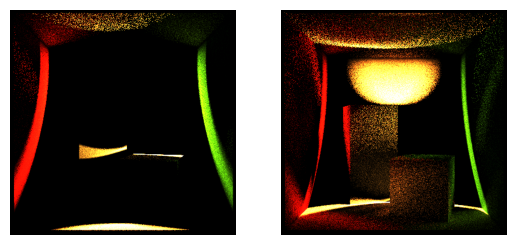

In [7]:
# Plot some frames of the computed transient image
import matplotlib.pyplot as plt


plt.subplot(1, 2, 1)
plt.axis("off")
plt.imshow(data_transient_tonemapped[:, :, 70])
plt.subplot(1, 2, 2)
plt.axis("off")
plt.imshow(data_transient_tonemapped[:, :, 100]);
